# Location Viz Checks
In order to improve my modeling of pitch location, I am going to be doing some vizualization here, such as pair plots, heatmaps, and others.

Importing packages:

In [41]:
import pandas as pd
import numpy as np
from bs4 import BeautifulSoup
import requests
import re
from IPython.core.display import display, HTML    # make sure Jupyter knows to display it as HTML
import time, os
from selenium import webdriver
from selenium.webdriver.common.keys import Keys
import unicodedata
import matplotlib.pyplot as plt
from pylab import rcParams
%matplotlib inline
rcParams['figure.figsize'] = 20,10
from scipy import stats
from sklearn.linear_model import LinearRegression
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, LassoCV, Ridge, RidgeCV, ElasticNetCV
from sklearn.metrics import r2_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

In [42]:
import pandas as pd
import numpy as np
from scipy import stats
from sklearn.linear_model import LinearRegression
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, LassoCV, Ridge, RidgeCV, ElasticNetCV
from sklearn.metrics import r2_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold

Importing in needed functions:

In [43]:
from pitch_cat_functions import *
from location_regression_functions import *

Pickling in initial data to work with:

In [44]:
pwd

'/Users/patrickbovard/Documents/GitHub/metis_final_project/Pitch_Classification'

In [45]:
with open('../Data/train_df_clusters.pickle','rb') as read_file:
    clusters_df = pickle.load(read_file)

In [46]:
clusters_df.head()

,inning,batter_id,pitcher_id,top,ab_id,p_score,stand,p_throws,event,home_team,...,cumulative_si_rate,cumulative_fc_rate,cumulative_kc_rate,cumulative_fs_rate,cumulative_kn_rate,cumulative_ep_rate,cumulative_fo_rate,cumulative_sc_rate,Name,Cluster
0,1.0,572761,452657,1.0,2.015000e+09,0.0,L,L,Groundout,chn,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matt Carpenter,0.0
1,1.0,572761,452657,1.0,2.015000e+09,0.0,L,L,Groundout,chn,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matt Carpenter,0.0
2,1.0,572761,452657,1.0,2.015000e+09,0.0,L,L,Groundout,chn,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matt Carpenter,0.0
3,1.0,572761,452657,1.0,2.015000e+09,0.0,L,L,Groundout,chn,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matt Carpenter,0.0
4,1.0,572761,452657,1.0,2.015000e+09,0.0,L,L,Groundout,chn,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matt Carpenter,0.0


WIth this, I'll retest on Max Scherzer:

In [47]:
ohe_cols = ['stand', 'p_throws', 'last_pitch_type', 'pitch_type']

In [48]:
scherzer_df = clusters_df[(clusters_df.pitcher_full_name == 'Max Scherzer') &(clusters_df.last_pitch_px.notnull())]

In [49]:
new_df = column_ohe_maker(scherzer_df, ohe_cols)

In [50]:
new_df.columns

Index(['inning', 'batter_id', 'pitcher_id', 'top', 'ab_id', 'p_score', 'event',
       'home_team', 'away_team', 'b_score', 'on_1b', 'on_2b', 'on_3b', 'px',
       'pz', 'zone', 'start_speed', 'type', 'b_count', 's_count', 'outs',
       'pitch_num', 'last_pitch_px', 'last_pitch_pz', 'last_pitch_speed',
       'pitcher_full_name', 'pitcher_run_diff', 'hitter_full_name',
       'Date_Time_Date', 'Season', 'cumulative_pitches', 'cumulative_ff_rate',
       'cumulative_sl_rate', 'cumulative_ft_rate', 'cumulative_ch_rate',
       'cumulative_cu_rate', 'cumulative_si_rate', 'cumulative_fc_rate',
       'cumulative_kc_rate', 'cumulative_fs_rate', 'cumulative_kn_rate',
       'cumulative_ep_rate', 'cumulative_fo_rate', 'cumulative_sc_rate',
       'Name', 'Cluster', 'stand_R', 'last_pitch_type_CU',
       'last_pitch_type_FC', 'last_pitch_type_FF', 'last_pitch_type_FT',
       'last_pitch_type_SL', 'last_pitch_type_UN', 'pitch_type_CU',
       'pitch_type_FC', 'pitch_type_FF', 'pitch_type_FT'

# Pair Plots

From here, I'll first do pairplots to check out relationships and correlation between features, potentially:

### Px:

In [51]:
#Columns to use for pairplot (i.e., includes Linear regression features for Px modeling)
pp_columns = ['inning', 'top', 'on_1b', 'on_2b', 'on_3b', 'b_count', 's_count', 'outs',
       'pitch_num', 'last_pitch_px', 'last_pitch_pz', 'last_pitch_speed',
       'pitcher_run_diff', 'cumulative_pitches', 'cumulative_ff_rate',
       'cumulative_sl_rate', 'cumulative_ft_rate', 'cumulative_ch_rate',
       'cumulative_cu_rate', 'cumulative_fc_rate',
              'Cluster', 'stand_R', 'last_pitch_type_CU',
       'last_pitch_type_FC', 'last_pitch_type_FF', 'last_pitch_type_FT',
       'last_pitch_type_SL', 'last_pitch_type_UN', 'pitch_type_CU',
       'pitch_type_FC', 'pitch_type_FF', 'pitch_type_FT', 'pitch_type_SL', 'px']

In [52]:
pairplot_df = new_df[pp_columns]

In [53]:
pairplot_df.describe()

,inning,top,on_1b,on_2b,on_3b,b_count,s_count,outs,pitch_num,last_pitch_px,...,last_pitch_type_FF,last_pitch_type_FT,last_pitch_type_SL,last_pitch_type_UN,pitch_type_CU,pitch_type_FC,pitch_type_FF,pitch_type_FT,pitch_type_SL,px
count,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000,...,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000,13613.000000
mean,3.964666,0.500845,0.230148,0.129509,0.055829,0.781532,0.964519,1.004114,2.910453,-0.012137,...,0.546536,0.007346,0.196871,0.000073,0.079997,0.050540,0.529567,0.006538,0.196797,-0.013448
std,2.099669,0.500018,0.420943,0.335774,0.229600,0.923550,0.840229,0.812035,1.756225,0.900776,...,0.497848,0.085396,0.397648,0.008571,0.271299,0.219064,0.499143,0.080595,0.397592,0.872402
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,-3.541925,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-3.541925
25%,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,-0.625000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.588000
50%,4.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,3.000000,0.017000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.008728
75%,6.000000,1.000000,0.000000,0.000000,0.000000,1.000000,2.000000,2.000000,4.000000,0.620000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.578266
max,9.000000,1.000000,1.000000,1.000000,1.000000,3.000000,2.000000,2.000000,13.000000,3.290000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.290000


Correlation:

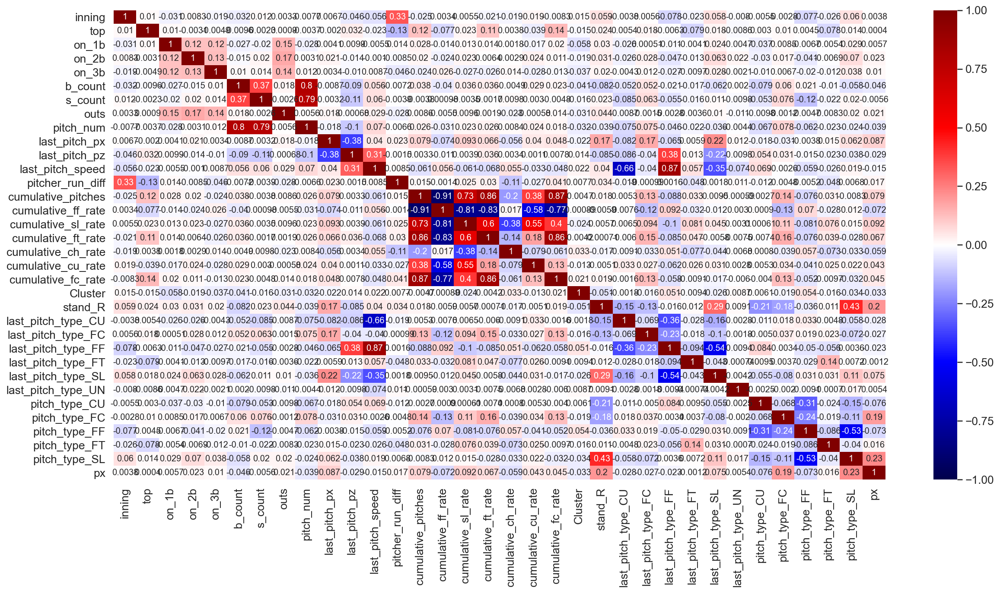

In [54]:
sns.heatmap(pairplot_df.corr(), cmap="seismic", annot=True, vmin=-1, vmax=1);

The biggest correlating factors on px seem to be the hitters standing (stand_R) and the pitch type one-hot-encoded features, which makes sense.  Those will tend to highly influence pitch location.

Relationships between variables:

In [88]:
sns.pairplot(pairplot_df, height=2, aspect=2);

# Residual Analysis

Here, I'll be vizualizing some residuals to see the model performance.

### Px:

In [58]:
columns = ['inning', 'b_count', 's_count', 'outs', 'pitcher_run_diff', 'stand_R',
          'last_pitch_type_CU', 'Cluster','cumulative_sl_rate', 'cumulative_ft_rate', 'cumulative_ch_rate',
       'cumulative_cu_rate', 'cumulative_fc_rate',
                  'last_pitch_px', 'last_pitch_pz', 'last_pitch_speed',
       'last_pitch_type_FC', 'last_pitch_type_FF', 'last_pitch_type_FT',
       'last_pitch_type_SL', 'last_pitch_type_UN',
       'pitch_type_CU', 'pitch_type_FC', 'pitch_type_FF', 'pitch_type_FT',
       'pitch_type_SL']

In [59]:
X = new_df[columns][new_df.last_pitch_px.notnull()]

In [60]:
y = new_df['px']

In [61]:
std = StandardScaler()
std.fit(X.values)
X_train_val_scaled = std.transform(X.values)

In [62]:
ridge_model = RidgeCV(cv= 5)
ridge_model.fit(X_train_val_scaled, y)
train_val_pred_px = ridge_model.predict(X_train_val_scaled)

Adding the Px prediction to chain into pz:

In [74]:
scherzer_df['px_pred'] = train_val_pred_px

<ipython-input-74-ed79ac8cfb5e>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scherzer_df['px_pred'] = train_val_pred_px


### Pz:

In [65]:
cols_pz = ['px_pred','inning', 'b_count', 's_count', 'outs', 'pitcher_run_diff', 'stand_R',
          'last_pitch_type_CU', 'Cluster','cumulative_sl_rate', 'cumulative_ft_rate', 'cumulative_ch_rate',
       'cumulative_cu_rate', 'cumulative_fc_rate',
                  'last_pitch_px', 'last_pitch_pz', 'last_pitch_speed',
       'last_pitch_type_FC', 'last_pitch_type_FF', 'last_pitch_type_FT',
       'last_pitch_type_SL', 'last_pitch_type_UN',
       'pitch_type_CU', 'pitch_type_FC', 'pitch_type_FF', 'pitch_type_FT',
       'pitch_type_SL']

In [66]:
X = new_df[cols_pz][new_df.last_pitch_px.notnull()]

In [67]:
y = new_df['pz']

In [68]:
std = StandardScaler()
std.fit(X.values)
X_train_val_scaled = std.transform(X.values)

In [69]:
ridge_model = RidgeCV(cv= 5)
ridge_model.fit(X_train_val_scaled, y)
train_val_pred_pz = ridge_model.predict(X_train_val_scaled)

In [73]:
scherzer_df['pz_pred'] = train_val_pred_pz

<ipython-input-73-5d122661f867>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scherzer_df['pz_pred'] = train_val_pred_pz


Plotting locations, by pitch type:

In [77]:
#Default Strikezone imagine layout - from data_cleaning.ipynb:
def strikezone_layout():
    plt.xlim(-4, 4)
    plt.ylim(0,5)
    plt.hlines(y=1.57, xmin=-0.71, xmax=0.71)
    plt.hlines(y=3.42, xmin=-0.71, xmax=0.71)
    plt.vlines(x=-0.71, ymin=1.57, ymax=3.42)
    plt.vlines(x=0.71, ymin=1.57, ymax=3.42)
    plt.show();

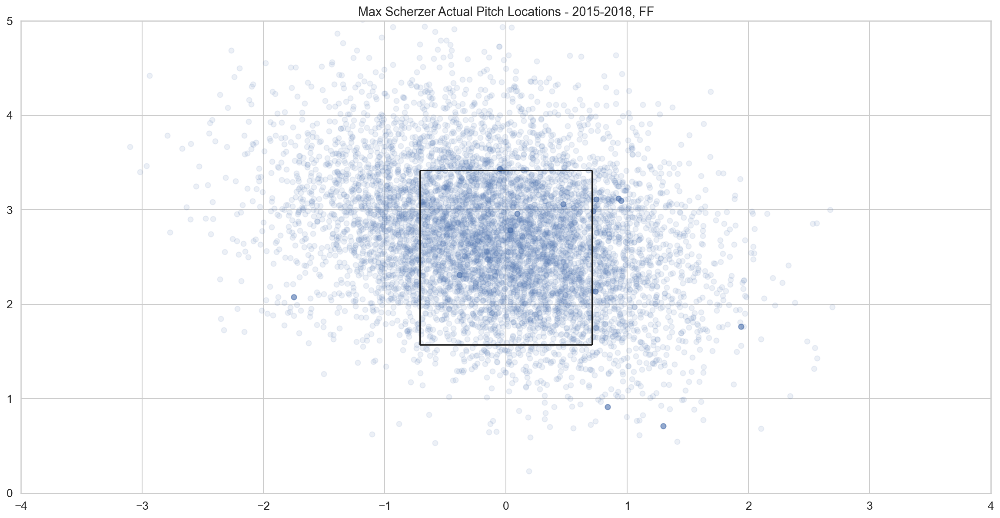

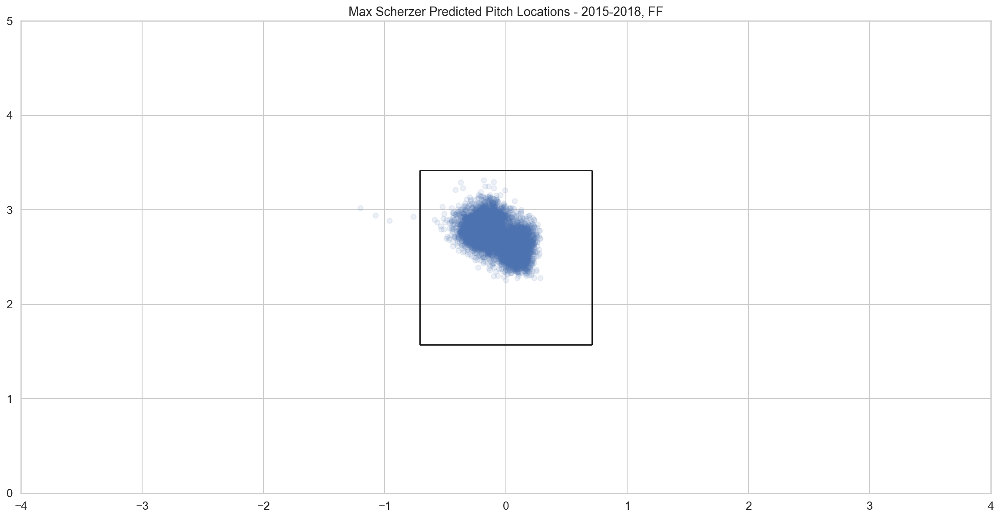

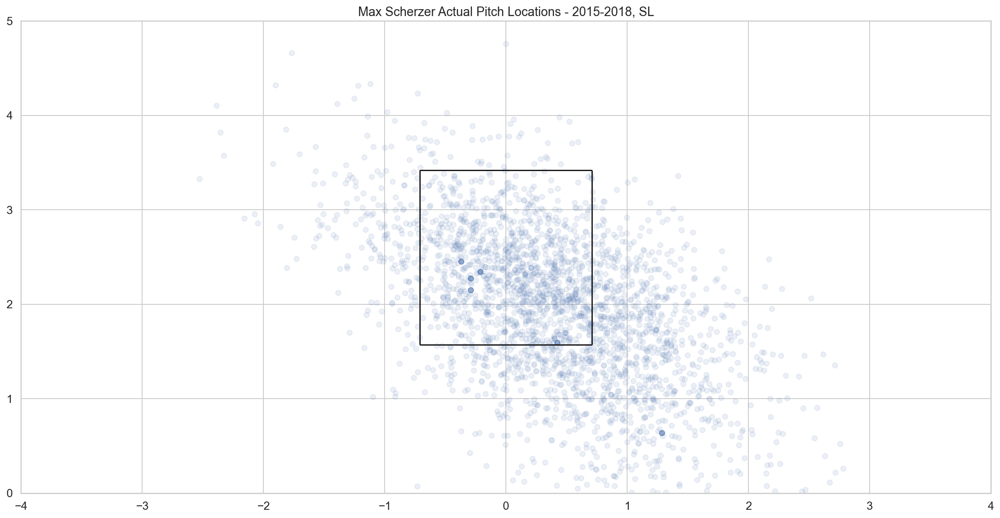

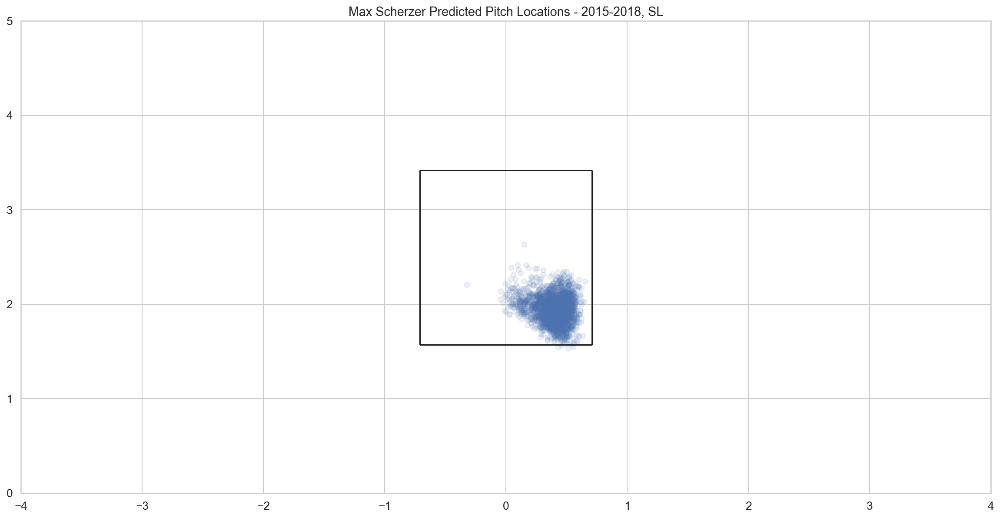

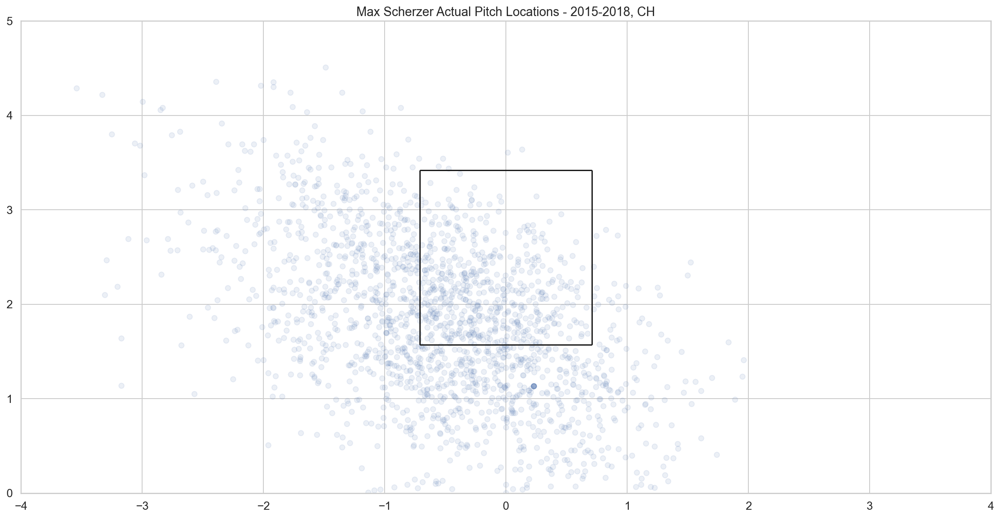

...

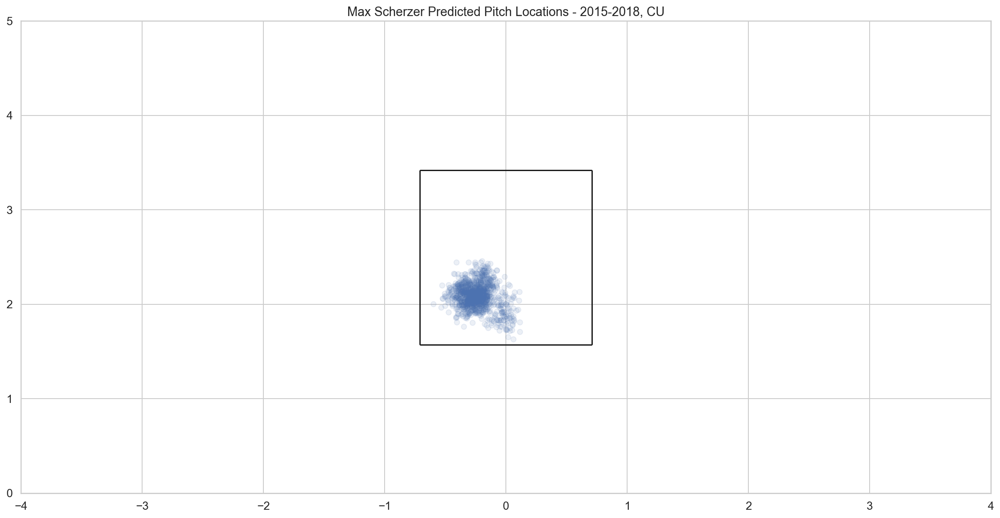

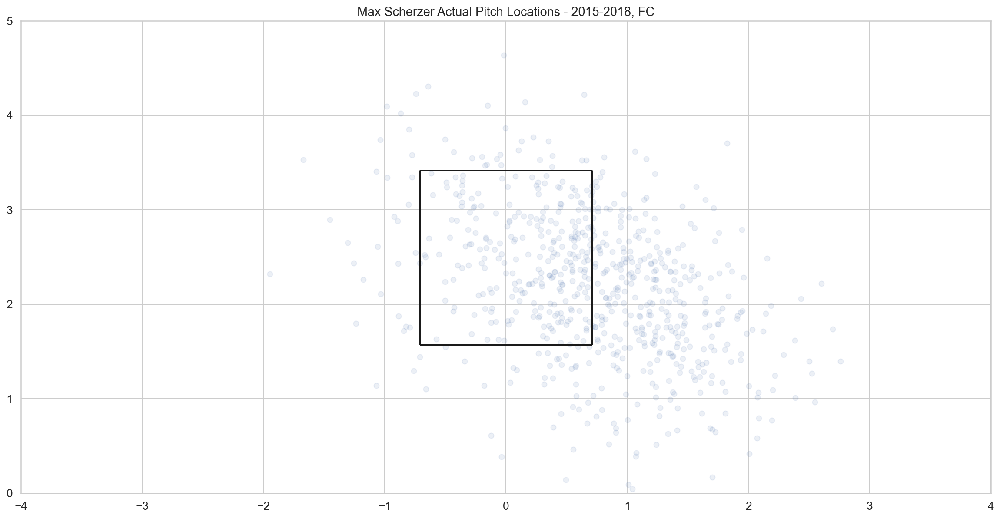

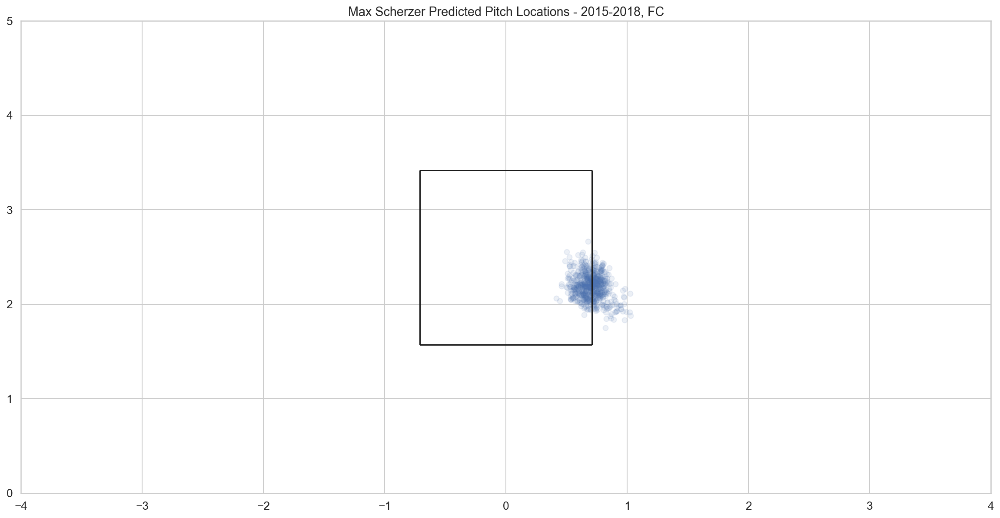

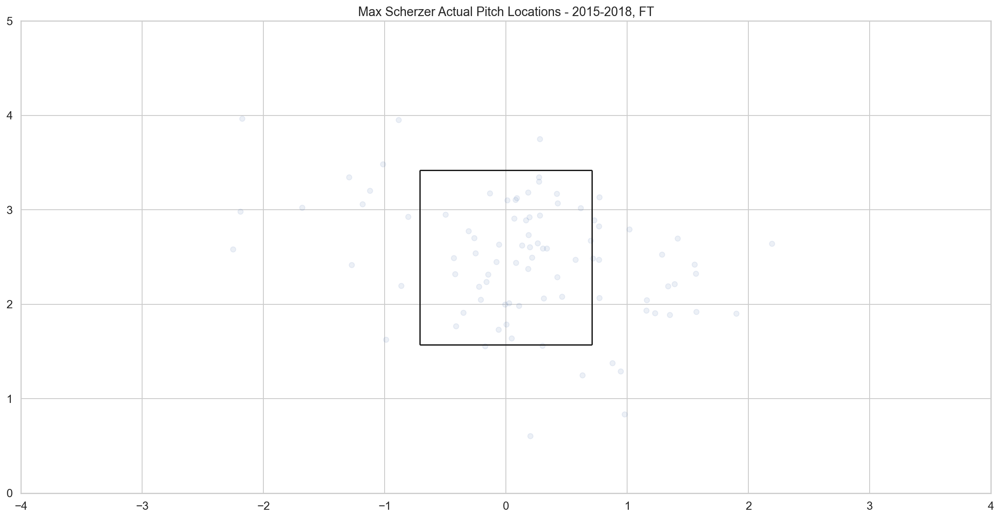

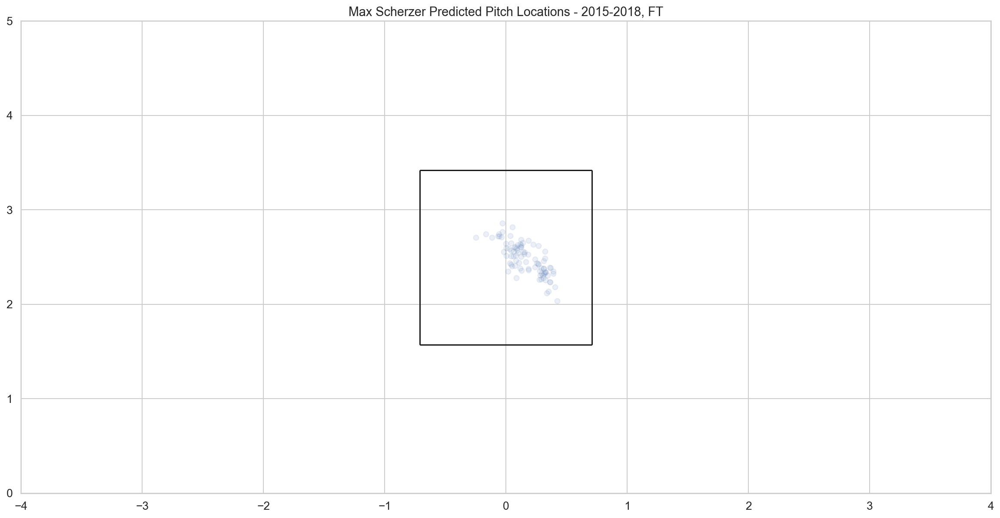

In [79]:
#plt.subplots(6, 2,figsize=(30,30))
for i, pitch_type in enumerate(scherzer_df.pitch_type.value_counts().index, 1):
    #plt.subplot(6,2,i)
    #Making even numbers actual pitches, odd predicted:
    plt.scatter(scherzer_df['px'][(scherzer_df.pitch_type == pitch_type)], scherzer_df['pz'][(scherzer_df.pitch_type == pitch_type)], alpha = 0.1)
    plt.title('Max Scherzer Actual Pitch Locations - 2015-2018, {}'.format(pitch_type))
    strikezone_layout();

    plt.scatter(scherzer_df['px_pred'][(scherzer_df.pitch_type == pitch_type)], scherzer_df['pz_pred'][(scherzer_df.pitch_type == pitch_type)], alpha = 0.1)
    plt.title('Max Scherzer Predicted Pitch Locations - 2015-2018, {}'.format(pitch_type))
    strikezone_layout();
        

With the predicted values feeding in, the predicted area is much smaller.

### Residual Distribution:

Adding residuals columns to the dataframe.

In [80]:
scherzer_df['px_res'] = scherzer_df.px - scherzer_df.px_pred
scherzer_df['pz_res'] = scherzer_df.pz - scherzer_df.pz_pred

<ipython-input-80-2de366c599aa>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scherzer_df['px_res'] = scherzer_df.px - scherzer_df.px_pred
<ipython-input-80-2de366c599aa>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scherzer_df['pz_res'] = scherzer_df.pz - scherzer_df.pz_pred


Plotting:

Px:

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


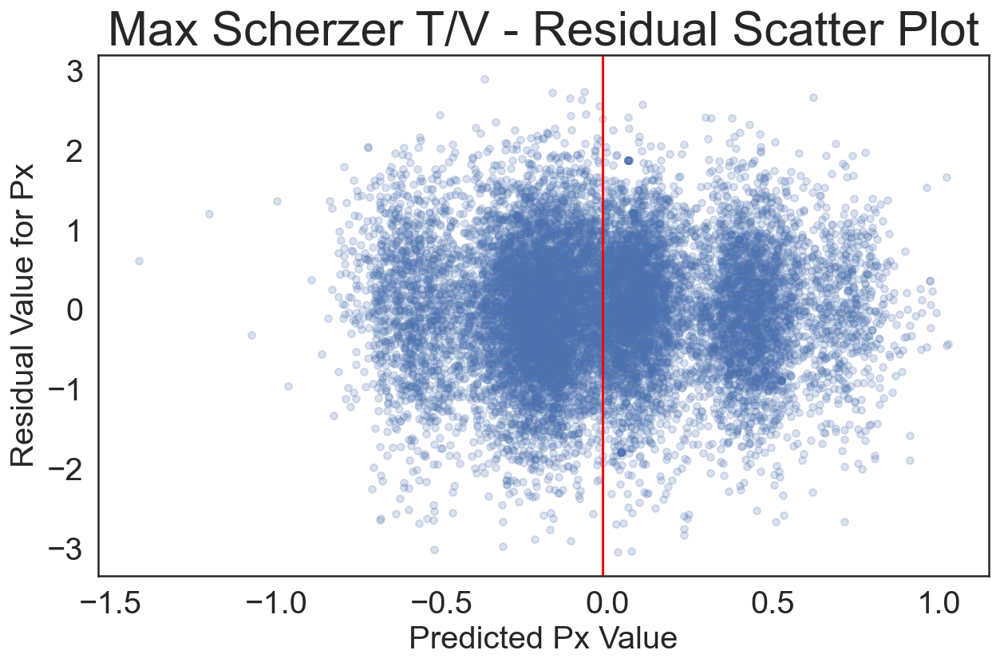

In [82]:
with sns.axes_style('white'):
    plot=scherzer_df.plot(kind='scatter',
                  x='px_pred',y='px_res',alpha=0.2,figsize=(10,6))
    plt.axvline(scherzer_df['px_pred'].mean(), 0, color='red')
    plt.title("Max Scherzer T/V - Residual Scatter Plot", size='30')
    plt.xlabel('Predicted Px Value', size=20)
    plt.ylabel('Residual Value for Px', size=20)
    plt.xticks(size=20)
    plt.yticks(size=20);
    plt.show()

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


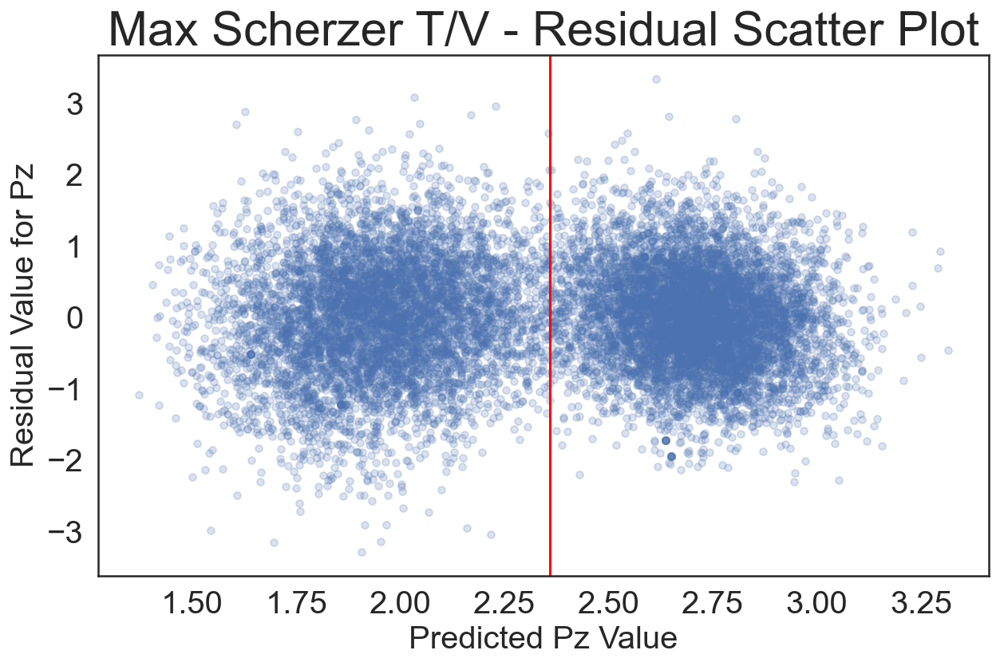

In [84]:
with sns.axes_style('white'):
    plot=scherzer_df.plot(kind='scatter',
                  x='pz_pred',y='pz_res',alpha=0.2,figsize=(10,6))
    plt.axvline(scherzer_df['pz_pred'].mean(), 0, color='red')
    plt.title("Max Scherzer T/V - Residual Scatter Plot", size='30')
    plt.xlabel('Predicted Pz Value', size=20)
    plt.ylabel('Residual Value for Pz', size=20)
    plt.xticks(size=20)
    plt.yticks(size=20);
    plt.show()

Q-Q Plot:

Px:

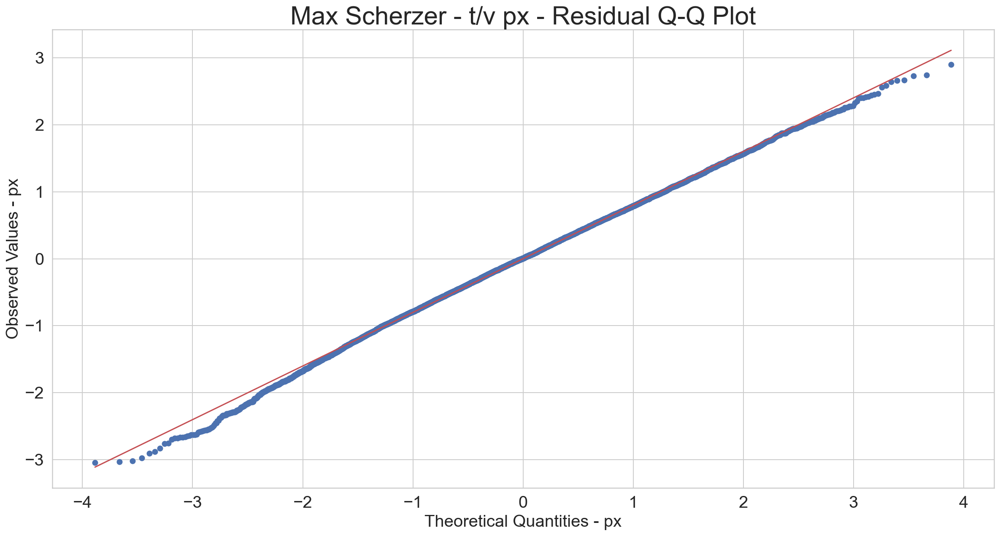

In [86]:
stats.probplot(scherzer_df['px_res'], dist="norm", plot=plt)
plt.title("Max Scherzer - t/v px - Residual Q-Q Plot", size='30')
plt.xlabel('Theoretical Quantities - px', size=20)
plt.ylabel('Observed Values - px', size=20)
plt.xticks(size=20)
plt.yticks(size=20);
plt.show()

Pz:

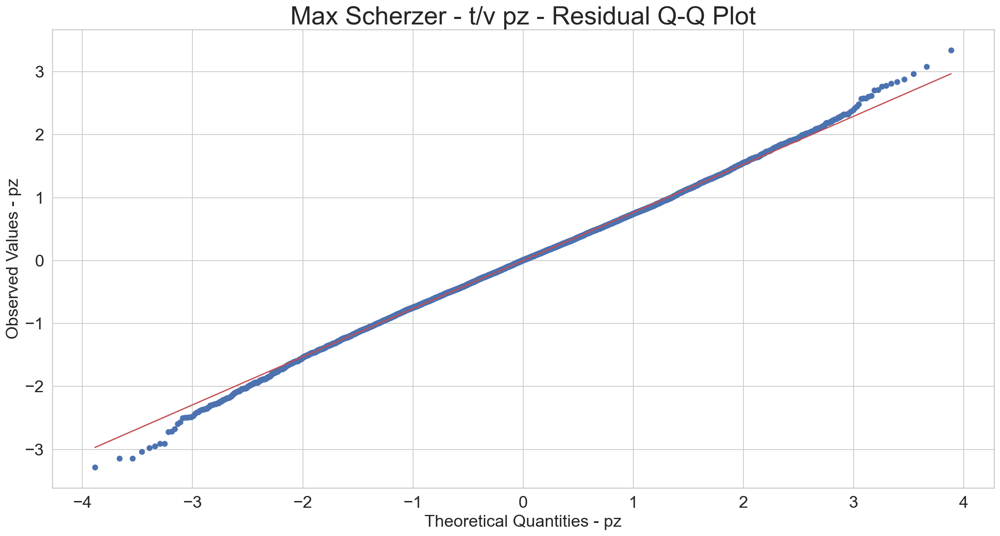

In [87]:
stats.probplot(scherzer_df['pz_res'], dist="norm", plot=plt)
plt.title("Max Scherzer - t/v pz - Residual Q-Q Plot", size='30')
plt.xlabel('Theoretical Quantities - pz', size=20)
plt.ylabel('Observed Values - pz', size=20)
plt.xticks(size=20)
plt.yticks(size=20);
plt.show()